### Please install the required Python modules/SDKs

In [1]:
! activate ai-azure-c1

import sys

sys.path.append("/opt/conda/envs/ai-azure-c1/lib/python3.8/site-packages")

Could not find conda environment: ai-azure-c1
You can list all discoverable environments with `conda info --envs`.



### This demo uses the latest pillow package to show the rectangular bounding box around the face, so please upgrade the pillow package using the command below:

In [2]:
!pip install Pillow==8.4

## Importing Useful Python Libraries or Packages

In [3]:

import sys
import requests
from io import BytesIO
from PIL import Image, ImageDraw


from azure.cognitiveservices.vision.face import FaceClient
from msrest.authentication import CognitiveServicesCredentials


import matplotlib.pyplot as plt

## Utility Functions

In [4]:
def show_image_in_cell(face_url):
    response = requests.get(face_url)
    img = Image.open(BytesIO(response.content))
    plt.figure(figsize=(20,10))
    plt.imshow(img)
    plt.show()

In [5]:
def show_image_object_in_cell(image_object):
    plt.figure(figsize=(20,10))
    plt.imshow(image_object)
    plt.show()

In [6]:
# TAKEN FROM THE Azure SDK Sample
# Convert width height to a point in a rectangle
def getRectangle(faceDictionary):
    rect = faceDictionary.face_rectangle
    left = rect.left
    top = rect.top
    right = left + rect.width
    bottom = top + rect.height
    
    return ((left, top), (right, bottom))

In [7]:
def drawFaceRectangles(source_file, detected_face_object) :
    # Download the image from the url
    response = requests.get(source_file)
    img = Image.open(BytesIO(response.content))
    # Draw a red box around every detected faces
    draw = ImageDraw.Draw(img)
    for face in detected_face_object:
        draw.rectangle(getRectangle(face), outline='red', width = 10)
    return img

## Accessing Specific Azure Resources 

In [8]:
KEY = "71307f07768144d6a76ee103b05d321d"
ENDPOINT = "https://nayana-face-api.cognitiveservices.azure.com/"

In [9]:
# Create an authenticated FaceClient.
face_client = FaceClient(ENDPOINT, CognitiveServicesCredentials(KEY))

## Setting up Input Data

### You can use your own images or use the following publically-available images:

In [10]:
face_x = "https://raw.githubusercontent.com/udacity/cd0461-building-computer-vision-solutions-with-azure-exercises/main/resources/obama-photo.jpg"
face = "https://raw.githubusercontent.com/udacity/cd0461-building-computer-vision-solutions-with-azure-exercises/main/resources/face-portrait.jpg"
family = "https://raw.githubusercontent.com/udacity/cd0461-building-computer-vision-solutions-with-azure-exercises/main/resources/obama_family.jpg"
family_x = "https://raw.githubusercontent.com/udacity/cd0461-building-computer-vision-solutions-with-azure-exercises/main/resources/obama-inauguration.jpg"


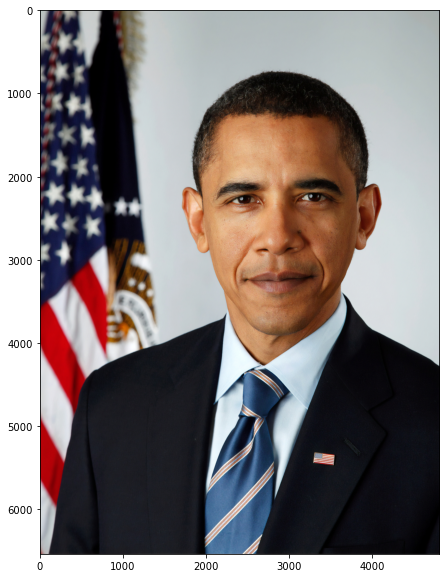

In [11]:
show_image_in_cell(face)

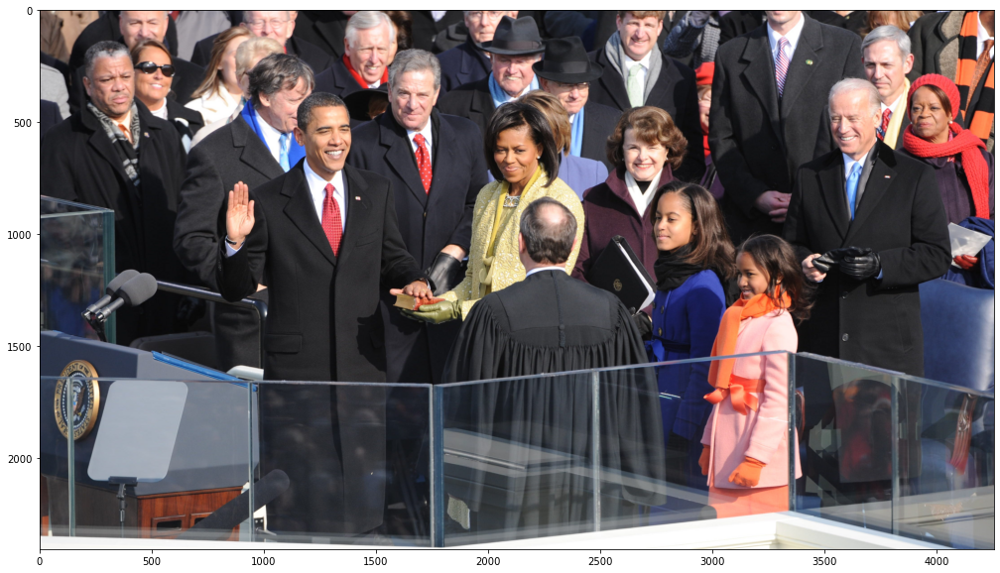

In [12]:
show_image_in_cell(family_x)

In [13]:
source_image = face

## Face Detection Functions Using Azure Face Service Python SDK

In [14]:
# Detect Face form an image
def detect_face_from_any_url(selected_image):
    detected_faces = face_client.face.detect_with_url(url=selected_image, detection_model='detection_03')
    if not detected_faces:
        raise Exception('No face detected from image {}'.format(single_image_name))        
    print('Total face(s) detected  from {}'.format(str(len(detected_faces))))
    return detected_faces

In [15]:
def list_all_faces_from_detected_face_object(detected_faces_object):
    print('We found total {} face(s) in selected face detected object.'.format(str(len(detected_faces_object))))
    for face in detected_faces_object: 
        print (face.face_id)

## Detecting faces from the input source image

In [16]:
source_faces_object = detect_face_from_any_url(source_image)

Total face(s) detected  from 1


In [17]:
list_all_faces_from_detected_face_object(source_faces_object)

We found total 1 face(s) in selected face detected object.
6c2cd5a1-9a10-458f-b698-7799c74ccfa8


## Showing bounding box around the detected face

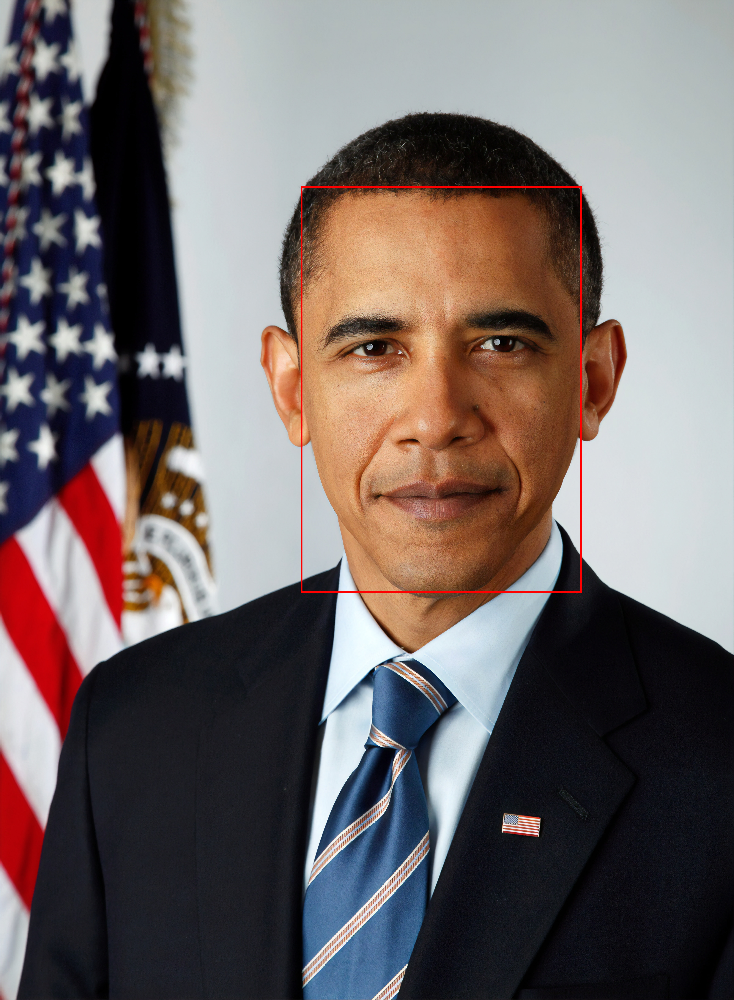

In [18]:
drawFaceRectangles(source_image, source_faces_object)

In [19]:
selected_image_2 = family_x

In [20]:
group_faces_object = detect_face_from_any_url(selected_image_2)

Total face(s) detected  from 20


In [21]:
list_all_faces_from_detected_face_object(group_faces_object)

We found total 20 face(s) in selected face detected object.
225999f5-c774-4ad0-95b4-3daf57df622f
13e0aabf-d240-4223-8b07-20968a45cd99
b55bae85-17c1-4061-9e13-2aca480adc55
20c1f87f-7dfd-4a91-a841-91bfe94689ed
3c2108a8-2d94-4bee-9fc1-a5f500e0a6ce
33ebf8ff-1d51-4cef-857e-59a7f527e1b7
a2138f45-dab6-42e7-94b4-387e4536bb60
42cf6d36-e1be-4c21-904d-51f66ad6ee5f
c3135adf-0377-4abf-b856-f47ee88a94a6
2ae1f5c9-5209-496a-82ef-8246a4873e1d
4c03bc23-9fdb-4791-9a2b-3cee31153905
cccd6200-c402-452e-b6fc-93e39720ba57
17979eb4-a410-4e6f-a92e-132384825f96
b83f11d5-0806-4f20-bf0a-b017f0ede57f
c9117e54-c152-4726-bd36-beefd4340067
0f777829-a535-42d4-b7c1-8584b9ee0c91
bd4c1b2e-7a66-4be2-a585-21ad7d84bdf4
ee5258e5-b3ba-439c-b25b-947d81ec81f2
faf9d2c7-dfa3-47a1-b437-7a58ae0561fc
9e5c482f-b7ab-4e58-9641-3f147f993c82


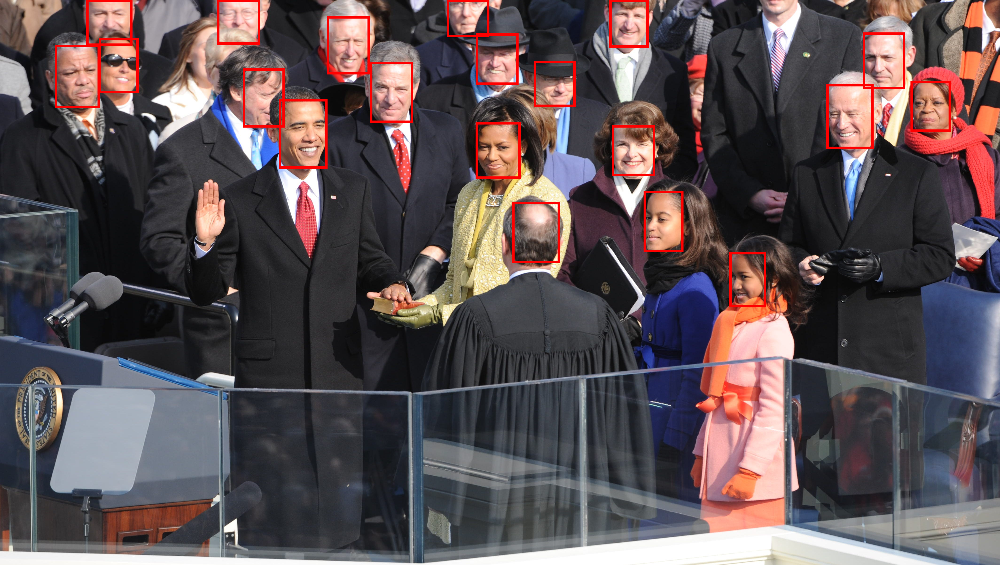

In [22]:
drawFaceRectangles(selected_image_2, group_faces_object)

In [23]:
for face in source_faces_object:
    source_image_face_id = face.face_id

In [24]:
print(source_image_face_id)

6c2cd5a1-9a10-458f-b698-7799c74ccfa8


In [25]:
group_image_face_IDs_list = list(map(lambda x: x.face_id, group_faces_object))

In [26]:
print('All faces in the group list {}'.format(str(len(group_image_face_IDs_list))))

All faces in the group list 20


## Find Similar API

In [27]:
similar_faces = face_client.face.find_similar(face_id=source_image_face_id, face_ids=group_image_face_IDs_list)

In [28]:
for similar_face in similar_faces:
    print(similar_face.face_id)

225999f5-c774-4ad0-95b4-3daf57df622f


In [29]:
for face in similar_faces:
		first_image_face_ID = face.face_id
		# The similar face IDs of the single face image and the group image do not need to match, 
		# they are only used for identification purposes in each image.
		# The similar faces are matched using the Cognitive Services algorithm in find_similar().
		face_info = next(x for x in group_faces_object if x.face_id == first_image_face_ID)
		if face_info:
			print('  Face ID: ', first_image_face_ID)
			print('    face_id: ', str(face_info.face_id))
			print('  Face rectangle:')
			print('    Left: ', str(face_info.face_rectangle.left))
			print('    Top: ', str(face_info.face_rectangle.top))
			print('    Width: ', str(face_info.face_rectangle.width))
			print('    Height: ', str(face_info.face_rectangle.height))

  Face ID:  225999f5-c774-4ad0-95b4-3daf57df622f
    face_id:  225999f5-c774-4ad0-95b4-3daf57df622f
  Face rectangle:
    Left:  1186
    Top:  422
    Width:  207
    Height:  295


In [30]:
def get_similar_face_object(similar_faces, group_faces_object):
    for face in similar_faces:
        first_image_face_ID = face.face_id
        face_info = next(x for x in group_faces_object if x.face_id == first_image_face_ID)
        if face_info:
            return face_info
        return None

In [31]:
similar_face_info = get_similar_face_object(similar_faces, group_faces_object)

In [ ]:
response = requests.get(selected_image_2)
img = Image.open(BytesIO(response.content))
# Draw a red box around every detected faces
draw = ImageDraw.Draw(img)
draw.rectangle(getRectangle(similar_face_info), outline='red', width = 10)
plt.figure(figsize=(20,10))
plt.imshow(img)
plt.show()


## Face - Verify API (Example)

In [ ]:
verify_result_same = face_client.face.verify_face_to_face(source_image_face_id, first_image_face_ID)

In [ ]:
print('Faces from {} & {} are of the same person, with confidence: {}'.format(source_image, selected_image_2, verify_result_same.confidence))
if verify_result_same.is_identical:
      print("Faces are Similar")
else:
      print('Faces from {} & {} are of a different person, with confidence: {}'.format(source_image, selected_image_2, verify_result_same.confidence))